# Explore data and visualize feature maps

## Necessary imports

In [1]:
import os
import sys
import json

import numpy as np
import matplotlib.pyplot as plt

import librosa.display

from git_root import git_root

sys.path.append(git_root("utils"))
from utils import read_in_data, generate_short_term_piece, quantize
from utils import load_params, load_config

import exploration as ex

import preprocessing_pipeline as pp

In [2]:
data_root = git_root("data", "sample_data")
train_root = os.path.join(data_root, "train")
test_root = os.path.join(data_root, "test")

In [3]:
params = load_params()
config = load_config()

In [4]:
seed = 6
R = np.random.RandomState(seed)

In [5]:
sampling_rate = params["sampling_rate"]
using_sample_data = config["using_sample_data"]

In [6]:
n_train = config["train_percent"] * config["sample_data_per_genre"] // 10
n_pieces = n_train * params["divide"]["number_pieces"]
n_mfcc_submaps = params["MFCC"]["n_submaps"]

## Load data

Loading and understanding the types of the loaded data:

In [7]:
data = read_in_data(sampling_rate, sample_data=using_sample_data)

180


In [8]:
max_l = 0
min_l = np.Inf
for d in data["train"]:
    max_l = max(max_l, d[1].shape[0])
    min_l = min(min_l, d[1].shape[0])
print(max_l)
print(min_l)

675808
661100


In [9]:
print(type(data))

<class 'dict'>


In [10]:
for key in data:
    print(key)

train
test


In [11]:
print(type(data["train"]))

<class 'list'>


In [12]:
# check that we have the expected number of tracks
ex.check_length(data, n_train)                                 

Actual length of the train data: 180
Expected length of the train data: 180


In [13]:
_ = ex.print_element(data, piece_wise=False, seed=seed)

Example:
        file_name: pop.00067.wav
        numpy_representation: [0.2953186  0.21789551 0.2272644  ... 0.14749146 0.30541992 0.38446045]
        shape of the array: (661504,)
        
        genre: pop
        


## Check audio files

Let's listen to two random tracks of each genre for three random genres:

In [14]:
ex.display_random_audio(seed=seed)

Genres picked are: ['reggae' 'classical' 'pop'] 

Tracks for genre - reggae
reggae.00096.wav


reggae.00094.wav


Tracks for genre - classical
classical.00081.wav


classical.00058.wav


Tracks for genre - pop
pop.00058.wav


pop.00023.wav


To the human ear, the genres seem fairly easy to distinguish, the human baseline would probably be very high on this task. They seem to have included som `RnB` in `pop` (e.g. `pop.00056.wav`). Some `country` labeling is debatable (e.g. `country.00059.wav`). You might want to listen to these tracks below

In [15]:
noticeable_tracks = [
    "pop.00056.wav",
    "country.00059.wav"
]

In [16]:
ex.display_some_audio(noticeable_tracks, ask_user=False)

pop.00056.wav


country.00059.wav


## Cut the numpy arrays into short-term pieces

In [17]:
data_pieces = pp.generate_short_term_pieces_from_dict(data)

In [18]:
# check that we have the expected number of pieces
ex.check_length(data_pieces, n_pieces, asserting=False)

Actual length of the train data: 2517
Expected length of the train data: 2520


We lost three pieces along the way! Probably from tracks that were shorter than the others. Let's check:

In [19]:
piece_count = {}
for piece in data_pieces['train']:
    if not piece[0] in piece_count:
        piece_count[piece[0]] = 1
    else:
        piece_count[piece[0]] += 1

In [20]:
shorter_tracks = []
for track in piece_count:
    if piece_count[track] < 14:
        shorter_tracks.append(track)
print(shorter_tracks)

['classical.00051.wav', 'country.00007.wav', 'rock.00038.wav']


We got three distinct tracks - of three distinct genres - so each of them is missing one piece. Let's fetch the numpy representations in the undivided data to look at their respective length.

In [21]:
shorter_track_arrays = {track: None for track in shorter_tracks}
for track in data["train"]:
    if track[0] in shorter_tracks:
        shorter_track_arrays[track[0]] = track

In [22]:
for track in shorter_track_arrays:
    print(len(shorter_track_arrays[track][1]))

661344
661100
661408


Comparing with a couple random lengths of tracks in data:

In [23]:
min_length = np.Inf
for i in range(4):
    random_length = len(data["train"][R.randint(n_train)][1])
    min_length = min(min_length, random_length)
    print(random_length)
print(f"minlength: {min_length}")

661504
661794
661504
661794
minlength: 661504


The longest of the misfit tracks is still at least ~100 data points smaller than the minimum length of randomly sampled tracks

We will pad the arrays that are too small with zeros to reach the minimum size of the arrays that passed the divide. For this, we need to fetch the minimum length of all passing arrays:

In [24]:
min_length = np.Inf
argmin = None
for track in data["train"]:
    if not track[0] in shorter_tracks:
        length = len(track[1])
        if length < min_length:
            argmin = track
            min_length = length
print(min_length)

661504


In [25]:
for i, track in enumerate(data["train"]):
    if track[0] in shorter_tracks:
        pad_length = min_length - len(track[1])
        data["train"][i] = (
            track[0], np.pad(track[1], pad_length), track[2]
        )

Now let's re-compute pieces and check:

In [26]:
data_pieces = pp.generate_short_term_pieces_from_dict(data)

In [27]:
# check that we have the expected number of pieces
ex.check_length(data_pieces, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


All good!

In [28]:
index = ex.print_element(data_pieces, seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [ 0.02127075  0.04501343  0.05236816 ... -0.16033936 -0.15911865
 -0.15805054]
        shape of the array: (88200,)
        piece_number: 3
        genre: blues
        


In [29]:
# print the element after that
_ = ex.print_element(data_pieces, i=index+1)

Example:
        file_name: blues.00094.wav
        numpy_representation: [ 0.01553345  0.02767944  0.02050781 ... -0.17245483 -0.21881104
 -0.21084595]
        shape of the array: (88200,)
        piece_number: 4
        genre: blues
        


Let's check that we haven't messed things up and are able to **re-construct coherent music pieces from some random short-term pieces**:

In [30]:
ex.display_random_audio_pieces(data_pieces, seed=seed)

Genres picked are: ['reggae' 'classical'] 

 -- Tracks for genre - reggae -- 
 
Full track:
reggae.00096.wav


2254
Random short-term pieces of the track:
piece 12


piece 8


Full track:
reggae.00094.wav


2240
Random short-term pieces of the track:
piece 7


piece 3


 -- Tracks for genre - classical -- 
 
Full track:
classical.00081.wav


448
Random short-term pieces of the track:
piece 11


piece 0


Full track:
classical.00058.wav


392
Random short-term pieces of the track:
piece 13


piece 4


Some samples give new insights on the genre: `metal` and `rock` are harder to distinguish than expected - the both of us working on this project weren't sure how to label some pieces!
We got a piece from `disco` that is hard to pin down to solely `disco`; a curious hybrid of `rock` and `disco`. This might harder than expected!

**The good news is we're able to reconstruct the sound from the short-term pieces and they correspond to the right full tracks!**

## Generate spectrograms and visualize them

In [31]:
spectrograms = pp.generate_spectrograms_from_dict(data_pieces)

In [32]:
# check that we have the expected number of maps
ex.check_length(spectrograms, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [33]:
index = ex.print_element(spectrograms, seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[-43.472244 -52.09221  -78.55463  ... -69.6326   -59.7054   -33.31118 ]
 [-44.466858 -49.818405 -56.11715  ... -64.83957  -64.023994 -33.374363]
 [-40.57818  -42.20219  -47.49246  ... -65.5232   -69.46307  -33.433685]
 ...
 [-80.       -80.       -80.       ... -80.       -80.       -80.      ]
 [-80.       -80.       -80.       ... -80.       -80.       -80.      ]
 [-80.       -80.       -80.       ... -80.       -80.       -80.      ]]
        shape of the array: (2051, 44)
        piece_number: 3
        genre: blues
        


Let's visualize a random spectrogram for a piece of a track:

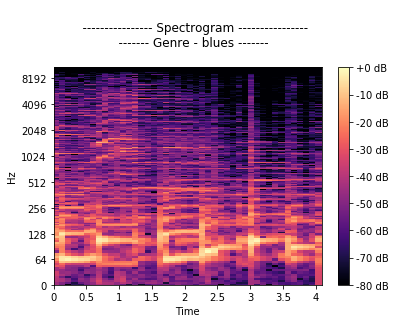

In [35]:
ex.plot_one_map(
    spectrograms['train'][index], "spectrogram"
)

**Let's now do so for all genres, with 5 randomly sampled pieces per genre**:

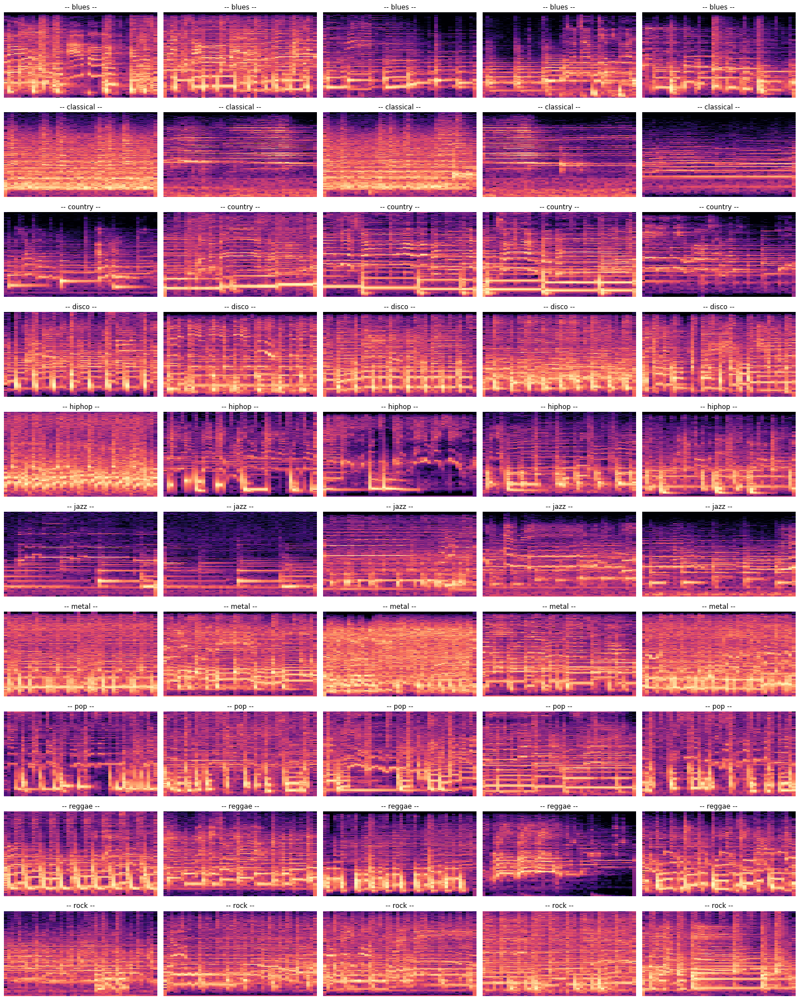

In [36]:
ex.plot_random_maps(
    spectrograms, n_per_genre=5, map_type="spectrogram", seed=seed
)

Now classifiying these images into genres for the human eye is a completely hopeless task (although domain knowledge might significantly improve the human-baseline accuracy, it's probably still going to be very far from an audio-based classification for the human ear).

A couple noticeable aspects of the spectrogram:

- `metal` is saturated in many frequencies (high dB)
- `jazz`, `blues` and `classical` seems mostly devoid of the higher frequencies
- the `hiphop` baseline (low frequencies) stands out against the rest of the spectrum
- the `disco` low frequency beats are somewhat more apparent than other genres, at regularly-spaced intervals
- time variations for `classical` music are more seamless than other genres

The genres evoked might be easier to classify than their counterparts, that show little stand-out features so far.

## Generate the mel-maps and visualize them

In [37]:
mel_maps = pp.generate_mel_maps_from_dict(data_pieces)

In [38]:
# check that we have the expected number of maps
ex.check_length(mel_maps, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [39]:
index = ex.print_element(mel_maps, seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[-13.327021   -3.7051144  -6.5059013 ... -11.67588   -15.612583
  -14.00071  ]
 [-19.210085  -11.105473  -15.283852  ... -19.537088  -21.539108
  -17.218056 ]
 [-26.152397  -17.751324  -18.340004  ... -27.545753  -29.169239
  -24.467754 ]
 ...
 [-55.04747   -53.566628  -55.966324  ... -80.        -71.32294
  -75.22452  ]
 [-59.30447   -60.618736  -59.998306  ... -80.        -80.
  -80.       ]
 [-74.52086   -74.565704  -78.14206   ... -80.        -80.
  -80.       ]]
        shape of the array: (40, 33)
        piece_number: 3
        genre: blues
        


**Now, time to visualize some mel maps: let's do so for all genres, with 5 randomly sampled pieces per genre - but first for the random mel map fetched above.**

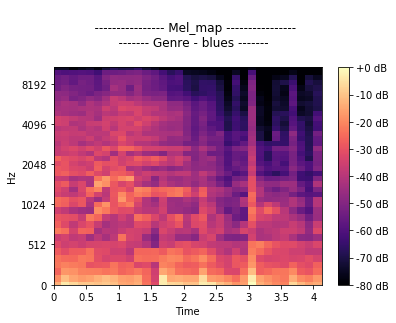

In [40]:
ex.plot_one_map(
    mel_maps['train'][index], "mel_map"
)

First we notice that the image is much more "pixelized" than the spectrograms. This is is because we only used 40 channels to compute the mel scale - as was suggested in the paper - whereas the spectrogram has 2051 bins frequency wise!

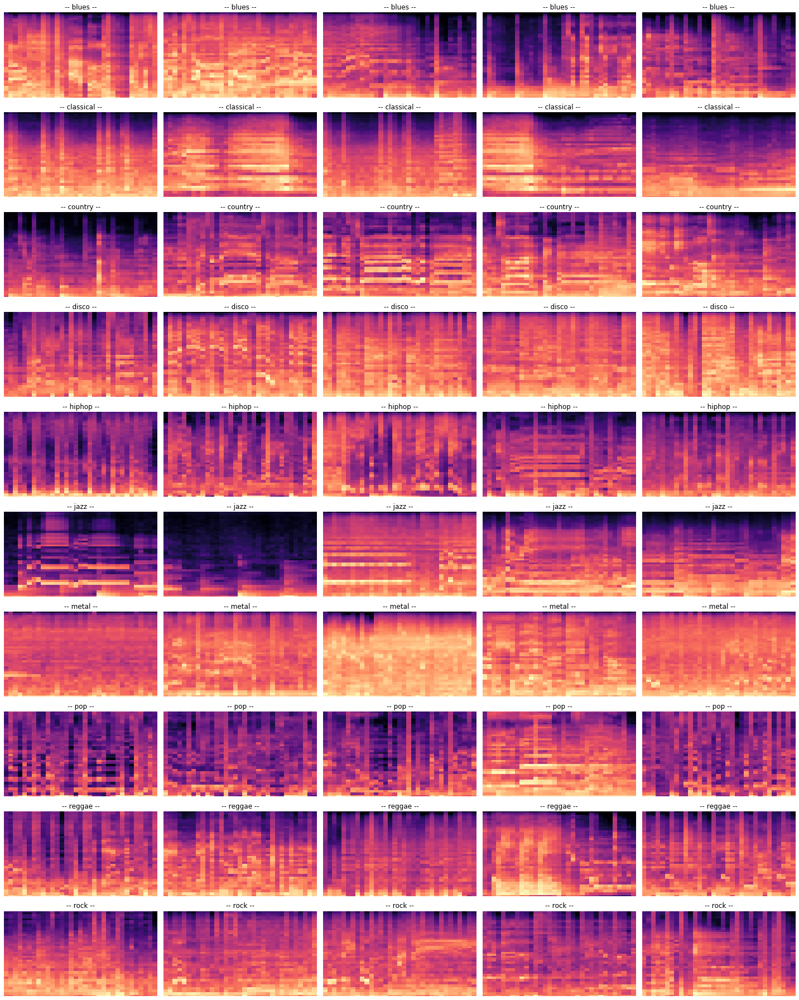

In [41]:
# setting the same seed as the `spectrograms` plot guarantees that we plot
# the same tracks - for a nice and easy comparison
ex.plot_random_maps(
    mel_maps, n_per_genre=5, map_type="mel_map", seed=seed
)

If anything, those maps seem harder to classify than the spectrograms, because of the coarse granularity of the map due to the low number of channels. 

The `pop` maps stand out from lack of intensity across a large majority of the bins

## Quantizing the maps

To understand how we should quantize the maps let's see the range of values (dB) they can take:

In [42]:
_, _ = ex.display_unique_extremes(mel_maps, "mel_map")

Unique mins of mel_map are:
[-80.       -79.991234 -79.98711  ... -42.13545  -41.013493 -40.196243] 

Unique maxs of mel_map are:
[-3.8146973e-06 -1.9073486e-06 -9.5367432e-07 -4.7683716e-07
  0.0000000e+00  5.9604645e-08  1.1920929e-07  4.7683716e-07
  9.5367432e-07  1.9073486e-06  3.8146973e-06]
    


In [43]:
_, _ = ex.display_unique_extremes(spectrograms, "spectrograms")

Unique mins of spectrograms are:
[-80.] 

Unique maxs of spectrograms are:
[-3.8146973e-06 -1.9073486e-06 -9.5367432e-07  0.0000000e+00
  1.9073486e-06  3.8146973e-06]
    


The paper mentions quantizing into 16 buckets: all values fit grossly within `[-80dB, 0dB]` so we will quantize in buckets of `5 dB` for all maps! (the last bucket will also contain values slightly higher than 0)

In [44]:
quantized_spectrograms = pp.generate_quantized_maps_from_dict(spectrograms)

In [45]:
# check that we have the expected number of maps
ex.check_length(quantized_spectrograms, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [46]:
index = ex.print_element(quantized_spectrograms, seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[7 5 0 ... 2 4 9]
 [7 6 4 ... 3 3 9]
 [7 7 6 ... 2 2 9]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]
        shape of the array: (2051, 44)
        piece_number: 3
        genre: blues
        


In [47]:
_, _ = ex.display_unique_extremes(quantized_spectrograms, "quantized spectrogram")

Unique mins of quantized spectrogram are:
[0] 

Unique maxs of quantized spectrogram are:
[15]
    


In [48]:
quantized_mel_maps = pp.generate_quantized_maps_from_dict(mel_maps)

In [49]:
# check that we have the expected number of maps
ex.check_length(quantized_mel_maps, n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [50]:
index = ex.print_element(quantized_mel_maps, seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[13 15 14 ... 13 12 13]
 [12 13 12 ... 12 11 12]
 [10 12 12 ... 10 10 11]
 ...
 [ 4  5  4 ...  0  1  0]
 [ 4  3  4 ...  0  0  0]
 [ 1  1  0 ...  0  0  0]]
        shape of the array: (40, 33)
        piece_number: 3
        genre: blues
        


In [51]:
_, _  = ex.display_unique_extremes(quantized_mel_maps, "quantized mel_map")

Unique mins of quantized mel_map are:
[0 1 2 3 4 5 6 7] 

Unique maxs of quantized mel_map are:
[15]
    


The minimums of the mel maps are much more spread out across different tracks as we saw before quantization: if this aligns roughly with the genres this might have a high predictive impact on the classification. Let's dive into this a bit more. Let's visualize how the counts of different minima vary across genres:

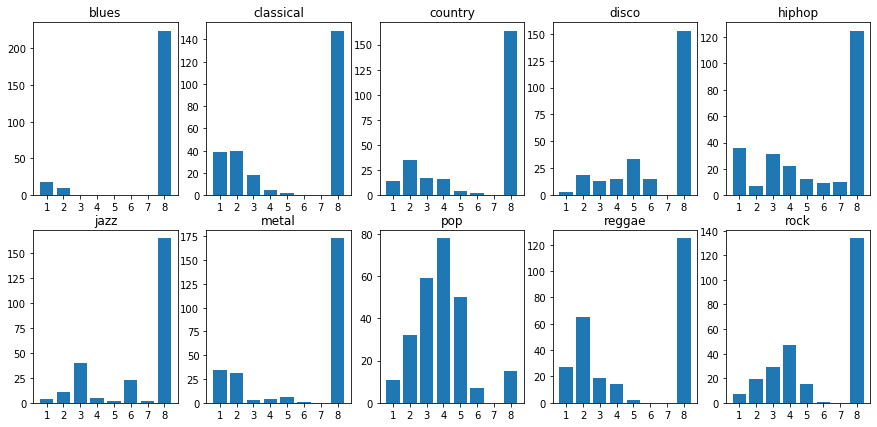

In [52]:
ex.display_genre_min_counts(quantized_mel_maps)

The minima seem to leak a significant amount of information:

- `pop` has the least amount of minima in the lowest bucket, on the contrary its mode is at the fifth bucket!
- all the other genres have their mode in the first bucket, by a significant amount
- `blues` solely has any minimums outside of the first bucket

The first bucket corresponds to a lot of silence and very low ambient sounds: the paper proposes to get rid of it after building the co-occurence maps, and we will do so! This will prevent leakage, especially regarding the `pop` genre

(A baseline that only uses the minima of the track pieces could be an interesting one to try out!)

**Also useful to check the types of our quantized maps**:

In [53]:
quantized_spec_ex = quantized_spectrograms["train"][index][1]
quantized_mel_ex = quantized_mel_maps["train"][index][1]
mel_ex = mel_maps["train"][index][1]
spec_ex = spectrograms["train"][index][1]

In [54]:
print(quantized_spec_ex.dtype)

uint8


In [55]:
print(quantized_mel_ex.dtype)

uint8


**Briefly compare quantized / un-quantized maps**:

In [56]:
spec_ex

array([[-43.472244, -52.09221 , -78.55463 , ..., -69.6326  , -59.7054  ,
        -33.31118 ],
       [-44.466858, -49.818405, -56.11715 , ..., -64.83957 , -64.023994,
        -33.374363],
       [-40.57818 , -42.20219 , -47.49246 , ..., -65.5232  , -69.46307 ,
        -33.433685],
       ...,
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ]], dtype=float32)

In [57]:
quantized_spec_ex

array([[7, 5, 0, ..., 2, 4, 9],
       [7, 6, 4, ..., 3, 3, 9],
       [7, 7, 6, ..., 2, 2, 9],
       ...,
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0],
       [0, 0, 0, ..., 0, 0, 0]], dtype=uint8)

Hum, we saw earlier that the max for all maps was always in the last bucket (ie. above -5 dB). This is not obvious here, so check:

In [58]:
assert spec_ex.max() >= -5.
print(spec_ex.max())

0.0


In [59]:
assert quantized_spec_ex.max() == 15
print(quantized_spec_ex.max())

15


In [60]:
mel_ex

array([[-13.327021 ,  -3.7051144,  -6.5059013, ..., -11.67588  ,
        -15.612583 , -14.00071  ],
       [-19.210085 , -11.105473 , -15.283852 , ..., -19.537088 ,
        -21.539108 , -17.218056 ],
       [-26.152397 , -17.751324 , -18.340004 , ..., -27.545753 ,
        -29.169239 , -24.467754 ],
       ...,
       [-55.04747  , -53.566628 , -55.966324 , ..., -80.       ,
        -71.32294  , -75.22452  ],
       [-59.30447  , -60.618736 , -59.998306 , ..., -80.       ,
        -80.       , -80.       ],
       [-74.52086  , -74.565704 , -78.14206  , ..., -80.       ,
        -80.       , -80.       ]], dtype=float32)

In [61]:
quantized_mel_ex

array([[13, 15, 14, ..., 13, 12, 13],
       [12, 13, 12, ..., 12, 11, 12],
       [10, 12, 12, ..., 10, 10, 11],
       ...,
       [ 4,  5,  4, ...,  0,  1,  0],
       [ 4,  3,  4, ...,  0,  0,  0],
       [ 1,  1,  0, ...,  0,  0,  0]], dtype=uint8)

The quantization looks OK!

**Now let's visualize some quantized maps**:

*Spectrograms*

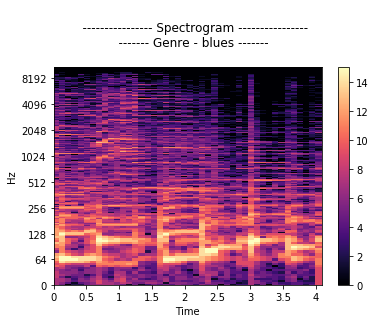

In [62]:
# spectrogram
ex.plot_one_map(
    quantized_spectrograms['train'][index], "spectrogram", quantized=True
)

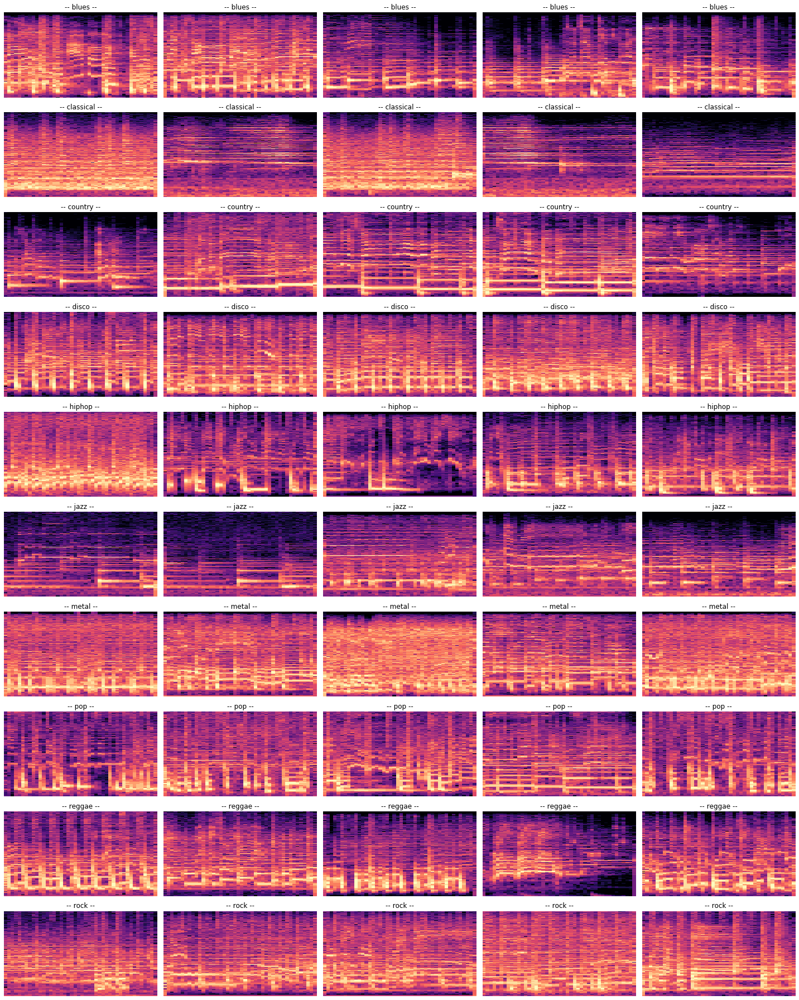

In [63]:
# same seed as before to compare the un-quantized maps
ex.plot_random_maps(
    quantized_spectrograms, n_per_genre=5, map_type="spectrogram", seed=seed
)

*Mel maps*

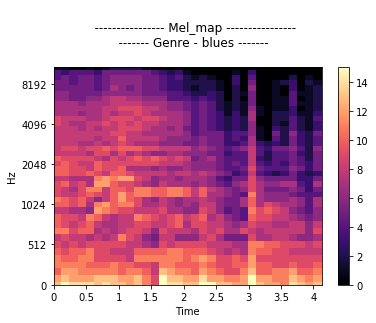

In [64]:
# mel_map
ex.plot_one_map(
    quantized_mel_maps['train'][index], "mel_map", quantized=True
)

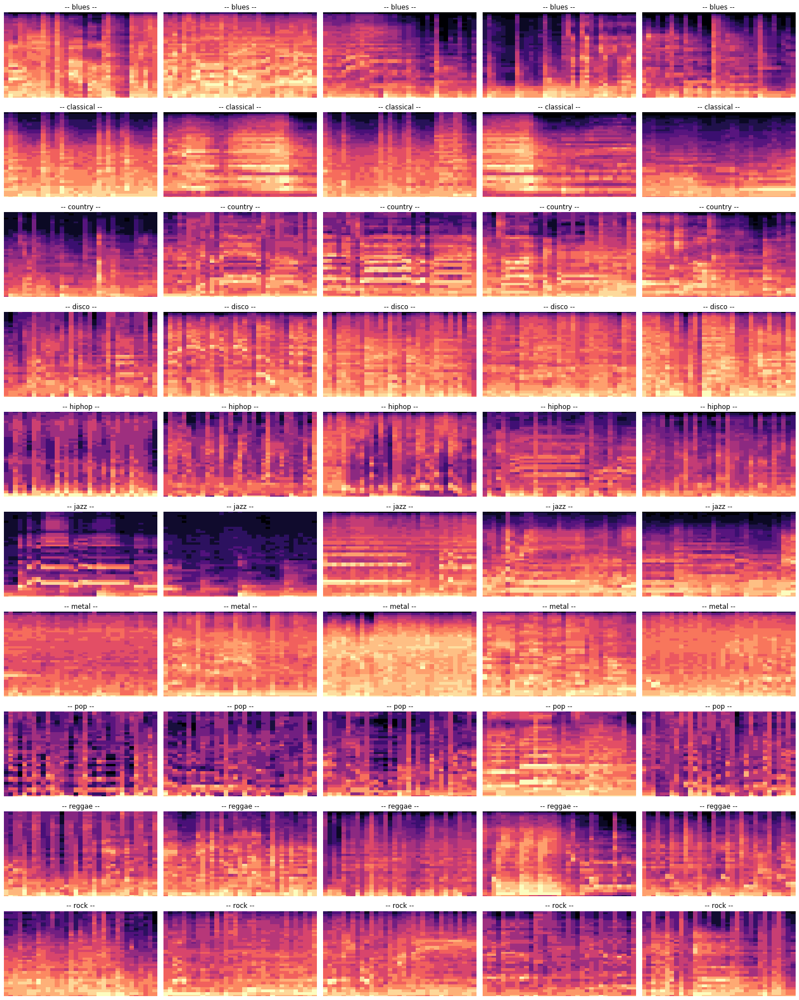

In [65]:
# same seed as before to compare the un-quantized maps
ex.plot_random_maps(
    quantized_mel_maps, n_per_genre=5, map_type="mel_map", seed=seed
)

The quantization doesn't look too lossy, especially for spectrograms that are much larger than our mel maps.

## Generate the GLCMs and visualize them

*From spectrograms*

In [66]:
spectrogram_glcms = pp.generate_glcms_from_dict(
    quantized_spectrograms, map_type="spectrogram"
)

The output of `generate_glcms_from_dict` is a list of different GLCMs. But for a spectrogram input, it only generates one type of GLCM so its length should be 1:

In [67]:
print(type(spectrogram_glcms))

<class 'list'>


In [68]:
assert len(spectrogram_glcms) == 1

In [69]:
# check that we have the expected number of maps
ex.check_length(spectrogram_glcms[0], n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [70]:
index = ex.print_element(spectrogram_glcms[0], seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[26118  3125  2208  1284   764   352   152    37     7     3     1     0
      0     0     0     0]
 [ 3610  1728  1570   995   552   242   113    49    13     6     4     0
      0     0     0     0]
 [ 2540  1740  1903  1552   866   474   240   115    35    15     5     1
      0     0     0     0]
 [ 1420  1215  1698  1877  1285   785   432   178    56    37    16     2
      0     0     0     0]
 [  694   690  1107  1458  1572  1125   653   324   113    44    22     6
      2     0     0     0]
 [  330   306   548   978  1309  1340   873   454   199    67    33    15
      2     4     0     0]
 [   84   126   280   463   796  1067   920   525   271    97    38    24
      2     4     2     0]
 [   10    32    88   214   352   547   687   611   365   146    57    29
     14     9     0     0]
 [    3    12    16    51   128   242   312   452   440   212    80    44
     14     3     0     0]
 [    1     2    

**Check the type of the GLCM:**

In [71]:
spec_glcm_ex = spectrogram_glcms[0]["train"][index]

In [72]:
print(spec_glcm_ex[1].dtype)

uint32


**Visualizing the map:**

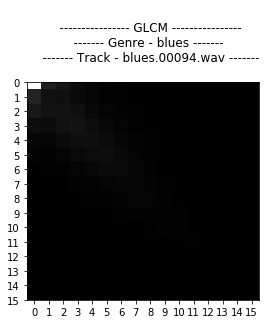

In [73]:
# spectrogram
ex.plot_one_glcm(spec_glcm_ex, 16)

The overwhelming majority of minimum level interactions prevent from seeing useful information from this map. Thankfully we will drop that level in the following and re-examine the map.

*From mel maps*

In [74]:
mel_map_glcms = pp.generate_glcms_from_dict(
    quantized_mel_maps, map_type="mel_map"
)

We should have 4 different GLCMs per map (one for each angle in `[0, 45, 90, 135]`

In [75]:
assert len(mel_map_glcms) == 4

In [76]:
for i in range(4):
    ex.check_length(mel_map_glcms[i], n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520


In [77]:
index = ex.print_element(mel_map_glcms[0], seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[43 13  8  5  3  3  1  0  0  0  0  0  0  0  0  0]
 [16  7 11  5  4  2  1  1  0  0  0  0  0  0  0  0]
 [ 5 16 10 10  6  5  4  1  0  0  0  0  0  0  0  0]
 [ 6  4 22  4  9  9  0  2  0  0  0  0  0  0  0  0]
 [ 2  2 10 21 16 19  4  3  4  0  1  2  0  0  0  0]
 [ 4  0  1 12 33 38 13  3  1  3  0  0  0  0  0  0]
 [ 2  3  0  1 10 31 38 19  7  5  0  0  1  0  0  0]
 [ 1  2  0  1  1  4 44 53 28 10  2  4  1  0  0  0]
 [ 0  0  0  1  4  1 12 50 74 30 10  5  0  1  0  0]
 [ 0  0  0  0  0  1  1 11 56 58 22  3  1  0  0  2]
 [ 0  0  0  0  0  0  0  8 10 34 28 13  5  0  0  0]
 [ 0  0  0  0  0  0  0  1  1  9 21 28  7  2  1  0]
 [ 0  0  0  0  0  0  0  0  0  2  6 10 11  5  1  2]
 [ 0  0  0  0  0  0  0  0  0  0  1  2  9  6  1  2]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  4  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  3  2  1]]
        shape of the array: (16, 16)
        piece_number: 3
        genre: blues
        


In [78]:
_ = ex.print_element(mel_map_glcms[1], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[27 10  6  6  1  3  0  0  0  0  0  0  0  0  0  0]
 [15  6 10  2  5  2  2  0  0  0  0  0  0  0  0  0]
 [12 10  8  6  7  5  3  2  0  0  0  0  0  0  0  0]
 [10 10 14  8  5  6  2  1  0  0  0  0  0  0  0  0]
 [ 6  5 15 14 13 18  3  3  3  2  1  1  0  0  0  0]
 [ 5  1  8 19 31 25  8  6  3  2  0  0  0  0  0  0]
 [ 4  1  1  2 16 31 31 12 13  3  2  1  0  0  0  0]
 [ 0  4  0  1  3 16 32 44 24 15  8  4  0  0  0  0]
 [ 0  0  0  2  3  7 22 41 68 27 13  5  0  0  0  0]
 [ 0  0  0  0  2  0  9 25 39 55 14  8  1  1  0  1]
 [ 0  0  0  0  0  0  5 11 23 25 19 10  5  0  0  0]
 [ 0  0  0  0  0  0  1  7  7 15 19 15  5  1  0  0]
 [ 0  0  0  0  0  0  0  0  1  6 10 11  6  2  0  1]
 [ 0  0  0  0  0  0  0  0  0  0  4  9  5  2  1  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  1  4  3  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  1  0  5  1  0  0]]
        shape of the array: (16, 16)
        piece_number: 3
        genre: blues
        


In [79]:
_ = ex.print_element(mel_map_glcms[2], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[50  4  1  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [17 23  3  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [ 5 14 35  3  1  0  0  0  0  0  0  0  0  0  0  0]
 [ 4  3 15 22 13  3  0  0  0  0  0  0  0  0  0  0]
 [ 3  2  2 25 41 11  3  1  0  0  0  0  0  0  0  0]
 [ 0  2  6 10 21 54 17  4  0  1  0  0  0  0  0  0]
 [ 0  0  0  0  9 35 40 20 11  3  1  1  0  0  0  0]
 [ 0  0  0  0  3 10 30 53 38 13  6  2  0  0  0  0]
 [ 0  0  0  0  0  2 18 41 66 47 12  3  1  0  0  0]
 [ 0  0  0  0  0  0  7 24 54 47 15  9  2  0  0  0]
 [ 0  0  0  0  0  0  3  7 15 31 30 12  1  0  0  0]
 [ 0  0  0  0  0  0  2  5  4 14 24 18  4  0  0  0]
 [ 0  0  0  0  0  0  0  0  2  1 11 17  7  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  7 12  3  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  4  4  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  0  1  3  1  2]]
        shape of the array: (16, 16)
        piece_number: 3
        genre: blues
        


In [80]:
_ = ex.print_element(mel_map_glcms[3], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[30  9  3  4  3  3  1  2  0  0  0  0  0  0  0  0]
 [14  9 12  2  1  1  4  0  0  0  0  0  0  0  0  0]
 [12  9 10 16  9  2  0  0  0  0  0  0  0  0  0  0]
 [ 8  9  5 12 14  6  4  1  1  0  0  0  0  0  0  0]
 [ 6  5  9  8 18 28  7  2  2  1  0  0  0  0  0  0]
 [ 5  3 12  9 23 30 19  9  2  1  0  0  0  0  0  0]
 [ 1  1  6  3  5 21 29 26 17  5  2  2  0  0  0  0]
 [ 0  2  0  2  3 12 21 36 37 19 16  4  0  0  0  0]
 [ 0  0  0  0  3  2 16 38 57 41 15  6  3  0  0  0]
 [ 0  0  0  0  3  2  9 17 47 45 16 11  1  0  0  0]
 [ 0  0  0  0  2  0  5 11 16 27 12 11  7  0  0  0]
 [ 0  0  0  0  0  1  1  6  7 10 25 15  1  1  0  0]
 [ 0  0  0  0  0  0  1  3  0  4  9 11  8  1  0  0]
 [ 0  0  0  0  0  0  0  0  1  0  2  6  6  5  0  1]
 [ 0  0  0  0  0  0  0  0  0  0  1  1  2  3  0  1]
 [ 0  0  0  0  0  0  0  0  1  1  0  1  3  0  1  0]]
        shape of the array: (16, 16)
        piece_number: 3
        genre: blues
        


In [81]:
for i in range(4):
    print(mel_map_glcms[i]["train"][index][1].dtype)

uint32
uint32
uint32
uint32


*Angle 0*

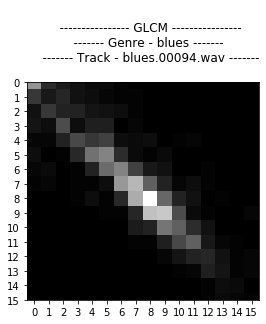

In [82]:
mel_glcm_ex_0 = mel_map_glcms[0]["train"][index]
ex.plot_one_glcm(mel_glcm_ex_0, 16)

*Angle 45*

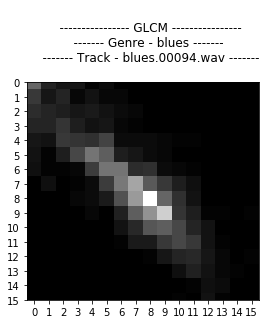

In [83]:
mel_glcm_ex_45 = mel_map_glcms[1]["train"][index]
ex.plot_one_glcm(mel_glcm_ex_45, 16)

*Angle 90*

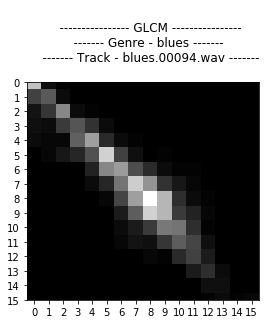

In [84]:
mel_glcm_ex_90 = mel_map_glcms[2]["train"][index]
ex.plot_one_glcm(mel_glcm_ex_90, 16)

*Angle 135*

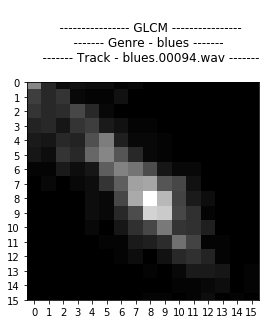

In [85]:
mel_glcm_ex_135 = mel_map_glcms[3]["train"][index]
ex.plot_one_glcm(mel_glcm_ex_135, 16)

The maps are much more readable than the spectrogram counterpart. The map for angle 90 seems much more specific: meaning that for the same time step intensities will more likely be close to one another for neighboring frequencies, but this is is less true for the time steps.

## Dropping the first grey level and visualizing the resulting GLCMs

**This step is particularly crucial as we observe what we are actually going to feed the CNN model**

*Spectrograms*

We're hoping to get a much more discriminatory GLCM from spectrogram with the lowest level removed:

In [86]:
dropped_spect_glcms = pp.drop_first_glcm_level_from_dict(
    spectrogram_glcms
)

In [87]:
assert len(dropped_spect_glcms) == 1

In [88]:
ex.check_length(dropped_spect_glcms[0], n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520


In [89]:
index = ex.print_element(dropped_spect_glcms[0], seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[1728 1570  995  552  242  113   49   13    6    4    0    0    0    0
     0]
 [1740 1903 1552  866  474  240  115   35   15    5    1    0    0    0
     0]
 [1215 1698 1877 1285  785  432  178   56   37   16    2    0    0    0
     0]
 [ 690 1107 1458 1572 1125  653  324  113   44   22    6    2    0    0
     0]
 [ 306  548  978 1309 1340  873  454  199   67   33   15    2    4    0
     0]
 [ 126  280  463  796 1067  920  525  271   97   38   24    2    4    2
     0]
 [  32   88  214  352  547  687  611  365  146   57   29   14    9    0
     0]
 [  12   16   51  128  242  312  452  440  212   80   44   14    3    0
     0]
 [   2   13   12   35   88  139  221  262  238  122   39    9    5    1
     0]
 [   0    2    1    4   13   35   63  116  213  179   75   15    9    4
     1]
 [   0    0    0    3    4   18   31   36   62  100  114   26    6    4
     2]
 [   0    0    0    0    1    1    5    9   19

In [90]:
dropped_spec_glcm_ex = dropped_spect_glcms[0]["train"][index]
print(dropped_spec_glcm_ex[1].dtype)

uint32


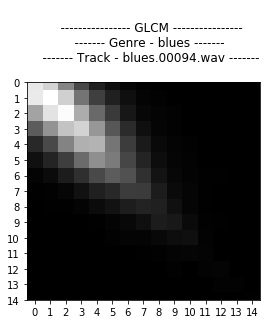

In [91]:
ex.plot_one_glcm(dropped_spec_glcm_ex, 15)

The differences are now much more visible. High dB are much rarer than low dB for this track, and it probably generalizes to most tracks. Neighboring frequencies are close to one another as was to expected.

**Now visualizing many spectrogram GLCMs per genre**:

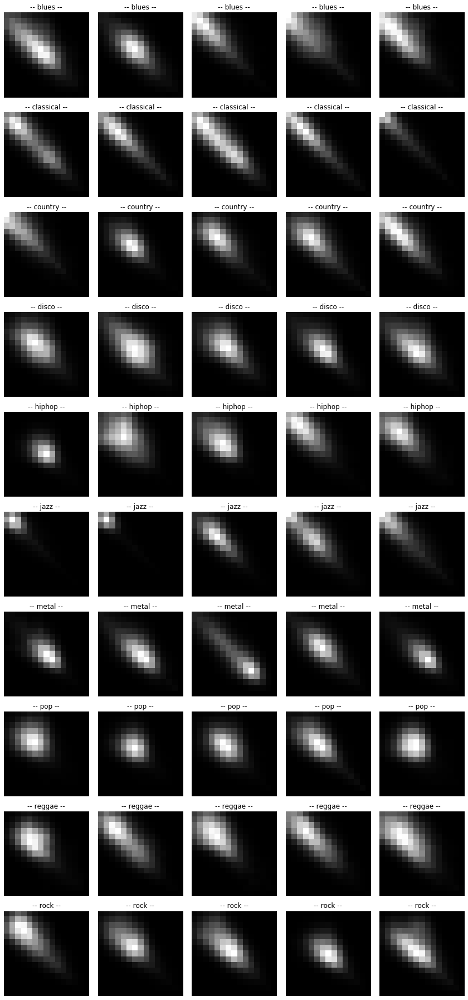

In [92]:
ex.plot_random_GLCMs(
    dropped_spect_glcms[0], n_per_genre=5, seed=seed
)

We can see some differences across some of the genres:
- `pop` contains more circle-like blobs than diagonally aligned activations than the other genres
- `rock` has both a wide and long diagonal trail - wider and longer than most of the other genres
- `reggae` contains more diverse shapes, with larger blobs
- `metal` seems more concentrated on higher intensity levels than other genres
- `hiphop` is a bit similar to the `pop` blobs, although they seem to occur at lower intensities
- `classical` music's diagonal trail is narrow, and translates the time-continuous spectrograms we witnessed earlier

*Mel maps*

In [93]:
dropped_mel_glcms = pp.drop_first_glcm_level_from_dict(
    mel_map_glcms
)

In [94]:
assert len(dropped_mel_glcms) == 4

In [95]:
for i in range(4):
    ex.check_length(dropped_mel_glcms[i], n_pieces)

Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520
Actual length of the train data: 2520
Expected length of the train data: 2520


In [96]:
index = ex.print_element(dropped_mel_glcms[0], seed=seed)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[ 7 11  5  4  2  1  1  0  0  0  0  0  0  0  0]
 [16 10 10  6  5  4  1  0  0  0  0  0  0  0  0]
 [ 4 22  4  9  9  0  2  0  0  0  0  0  0  0  0]
 [ 2 10 21 16 19  4  3  4  0  1  2  0  0  0  0]
 [ 0  1 12 33 38 13  3  1  3  0  0  0  0  0  0]
 [ 3  0  1 10 31 38 19  7  5  0  0  1  0  0  0]
 [ 2  0  1  1  4 44 53 28 10  2  4  1  0  0  0]
 [ 0  0  1  4  1 12 50 74 30 10  5  0  1  0  0]
 [ 0  0  0  0  1  1 11 56 58 22  3  1  0  0  2]
 [ 0  0  0  0  0  0  8 10 34 28 13  5  0  0  0]
 [ 0  0  0  0  0  0  1  1  9 21 28  7  2  1  0]
 [ 0  0  0  0  0  0  0  0  2  6 10 11  5  1  2]
 [ 0  0  0  0  0  0  0  0  0  1  2  9  6  1  2]
 [ 0  0  0  0  0  0  0  0  0  0  0  1  4  3  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  1  3  2  1]]
        shape of the array: (15, 15)
        piece_number: 3
        genre: blues
        


In [97]:
_ = ex.print_element(dropped_mel_glcms[1], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[ 6 10  2  5  2  2  0  0  0  0  0  0  0  0  0]
 [10  8  6  7  5  3  2  0  0  0  0  0  0  0  0]
 [10 14  8  5  6  2  1  0  0  0  0  0  0  0  0]
 [ 5 15 14 13 18  3  3  3  2  1  1  0  0  0  0]
 [ 1  8 19 31 25  8  6  3  2  0  0  0  0  0  0]
 [ 1  1  2 16 31 31 12 13  3  2  1  0  0  0  0]
 [ 4  0  1  3 16 32 44 24 15  8  4  0  0  0  0]
 [ 0  0  2  3  7 22 41 68 27 13  5  0  0  0  0]
 [ 0  0  0  2  0  9 25 39 55 14  8  1  1  0  1]
 [ 0  0  0  0  0  5 11 23 25 19 10  5  0  0  0]
 [ 0  0  0  0  0  1  7  7 15 19 15  5  1  0  0]
 [ 0  0  0  0  0  0  0  1  6 10 11  6  2  0  1]
 [ 0  0  0  0  0  0  0  0  0  4  9  5  2  1  0]
 [ 0  0  0  0  0  0  0  0  0  0  1  4  3  0  0]
 [ 0  0  0  0  0  0  0  0  0  1  0  5  1  0  0]]
        shape of the array: (15, 15)
        piece_number: 3
        genre: blues
        


In [98]:
_ = ex.print_element(dropped_mel_glcms[2], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[23  3  0  0  0  0  0  0  0  0  0  0  0  0  0]
 [14 35  3  1  0  0  0  0  0  0  0  0  0  0  0]
 [ 3 15 22 13  3  0  0  0  0  0  0  0  0  0  0]
 [ 2  2 25 41 11  3  1  0  0  0  0  0  0  0  0]
 [ 2  6 10 21 54 17  4  0  1  0  0  0  0  0  0]
 [ 0  0  0  9 35 40 20 11  3  1  1  0  0  0  0]
 [ 0  0  0  3 10 30 53 38 13  6  2  0  0  0  0]
 [ 0  0  0  0  2 18 41 66 47 12  3  1  0  0  0]
 [ 0  0  0  0  0  7 24 54 47 15  9  2  0  0  0]
 [ 0  0  0  0  0  3  7 15 31 30 12  1  0  0  0]
 [ 0  0  0  0  0  2  5  4 14 24 18  4  0  0  0]
 [ 0  0  0  0  0  0  0  2  1 11 17  7  0  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  7 12  3  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  4  4  0  0]
 [ 0  0  0  0  0  0  0  0  0  0  0  1  3  1  2]]
        shape of the array: (15, 15)
        piece_number: 3
        genre: blues
        


In [99]:
_ = ex.print_element(dropped_mel_glcms[3], i=index)

Example:
        file_name: blues.00094.wav
        numpy_representation: [[ 9 12  2  1  1  4  0  0  0  0  0  0  0  0  0]
 [ 9 10 16  9  2  0  0  0  0  0  0  0  0  0  0]
 [ 9  5 12 14  6  4  1  1  0  0  0  0  0  0  0]
 [ 5  9  8 18 28  7  2  2  1  0  0  0  0  0  0]
 [ 3 12  9 23 30 19  9  2  1  0  0  0  0  0  0]
 [ 1  6  3  5 21 29 26 17  5  2  2  0  0  0  0]
 [ 2  0  2  3 12 21 36 37 19 16  4  0  0  0  0]
 [ 0  0  0  3  2 16 38 57 41 15  6  3  0  0  0]
 [ 0  0  0  3  2  9 17 47 45 16 11  1  0  0  0]
 [ 0  0  0  2  0  5 11 16 27 12 11  7  0  0  0]
 [ 0  0  0  0  1  1  6  7 10 25 15  1  1  0  0]
 [ 0  0  0  0  0  1  3  0  4  9 11  8  1  0  0]
 [ 0  0  0  0  0  0  0  1  0  2  6  6  5  0  1]
 [ 0  0  0  0  0  0  0  0  0  1  1  2  3  0  1]
 [ 0  0  0  0  0  0  0  1  1  0  1  3  0  1  0]]
        shape of the array: (15, 15)
        piece_number: 3
        genre: blues
        


In [100]:
for i in range(4):
    print(dropped_mel_glcms[i]["train"][index][1].dtype)

uint32
uint32
uint32
uint32


*Angle 0*

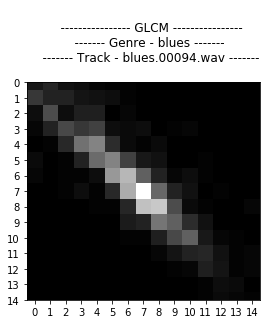

In [101]:
dropped_mel_glcm_ex_0 = dropped_mel_glcms[0]["train"][index]
ex.plot_one_glcm(dropped_mel_glcm_ex_0, 15)

*Angle 45*

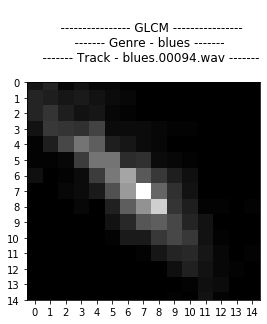

In [102]:
dropped_mel_glcm_ex_45 = dropped_mel_glcms[1]["train"][index]
ex.plot_one_glcm(dropped_mel_glcm_ex_45, 15)

*Angle 90*

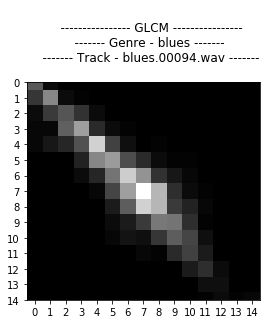

In [103]:
dropped_mel_glcm_ex_90 = dropped_mel_glcms[2]["train"][index]
ex.plot_one_glcm(dropped_mel_glcm_ex_90, 15)

*Angle 135*

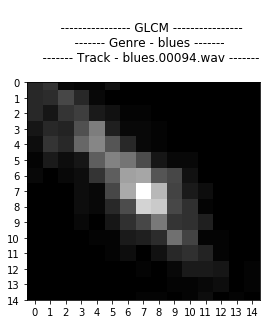

In [104]:
dropped_mel_glcm_ex_135 = dropped_mel_glcms[3]["train"][index]
ex.plot_one_glcm(dropped_mel_glcm_ex_135, 15)

Nothing new from before dropping the first level.

**Now visualizing several mel map GLCMs per genre**:

*Angle 0*

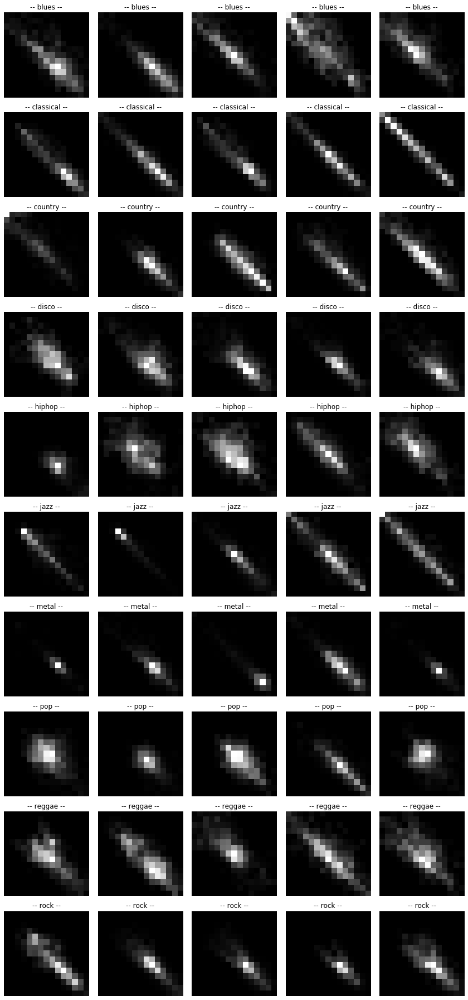

In [105]:
ex.plot_random_GLCMs(
    dropped_mel_glcms[0], n_per_genre=5, seed=seed
)

The mel spectrograms seem more concentrated on average than the spectrogram (ie. more specific activation patterns). A couple observations:

- `rock` has an especially long diagonal trail
- `metal` is highly concentrated in high intensities in very small blops
- `hiphop` activates a large mass of co-occurences, a bit chaotic and straying for the little blop structure of some genres of the diagonally-aligned structure of others
- `classical` spans the narrowest diagonal trails and the longest

*Angle 45*

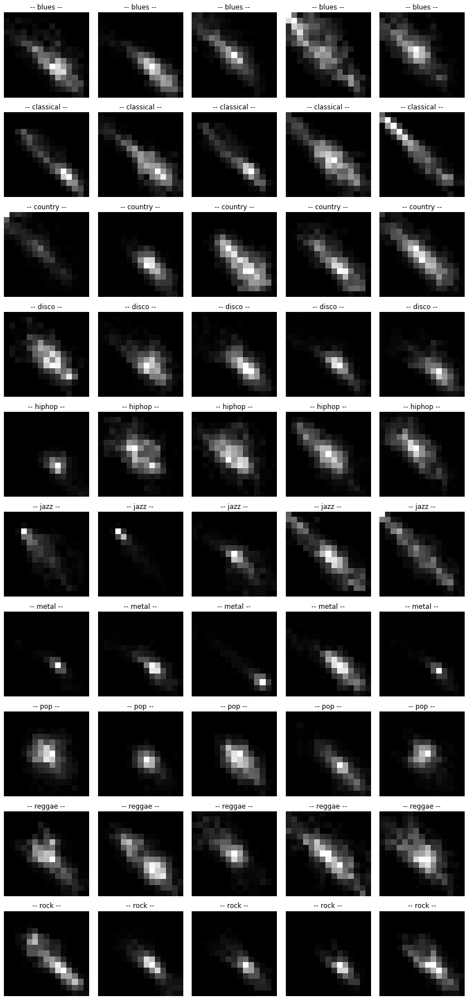

In [106]:
ex.plot_random_GLCMs(
    dropped_mel_glcms[1], n_per_genre=5, seed=seed
)

With an angle of `45` degrees between considered pairs of pixels for building the co-occurence maps, conclusions are harder to make. We could note that `metal` kept its highly concentrated structure, but most other genres have become wider and less specific in their activation patterns>

*Angle 90*

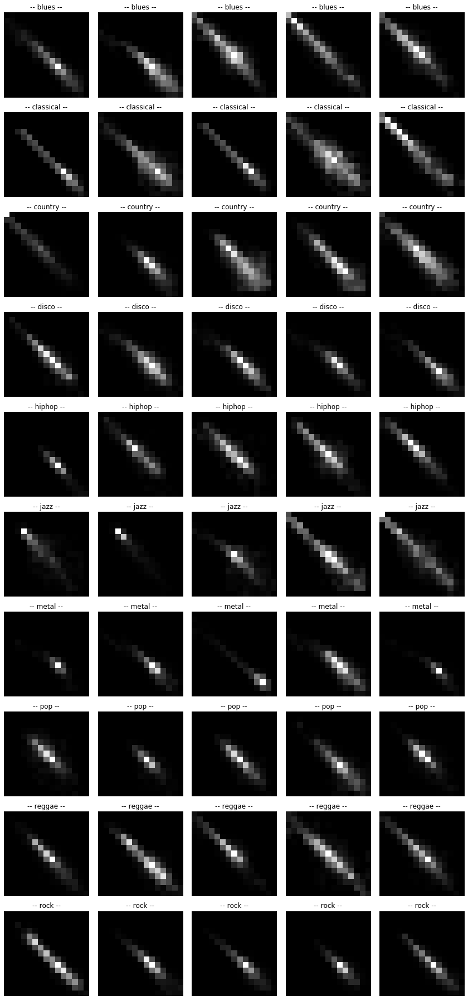

In [107]:
ex.plot_random_GLCMs(
    dropped_mel_glcms[2], n_per_genre=5, seed=seed
)

As previously witnessed, an angle of `90` degrees makes from highly diagonally-aligned patterns. This projections makes the problem  much harder than it has to be, and `metal` is really the only genre that stands out by its highly concentrated structure.

*Angle 135*

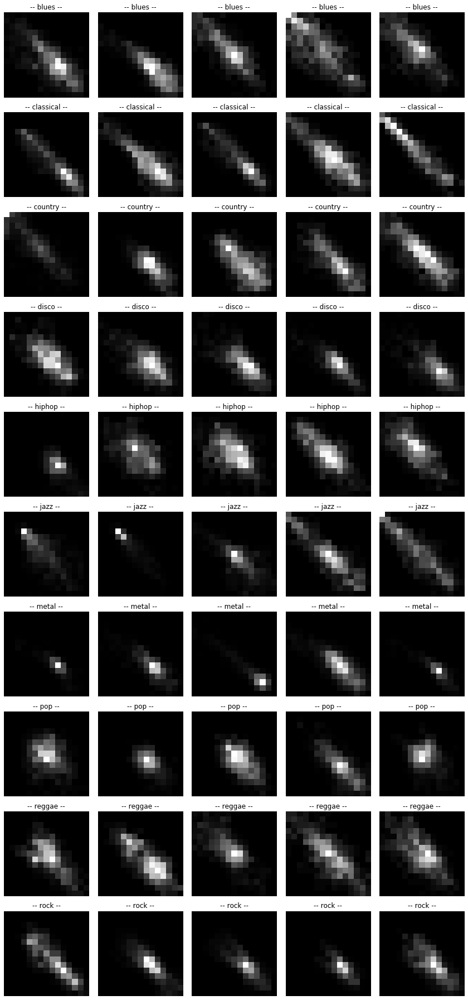

In [108]:
ex.plot_random_GLCMs(
    dropped_mel_glcms[3], n_per_genre=5, seed=seed
)

Very similar to the `45` pattern by symmetry.

## Generate the time-MFCC and visualize them

The time-MFCC is an orthogonal mapping that will be used to compare to the result obtained with our GLCMs as a benchmark. Let's visualize the maps:

In [14]:
mfccs = pp.generate_MFCC_from_dict(data)

In [15]:
print(type(mfccs))

<class 'dict'>


In [16]:
print(type(mfccs["train"]))

<class 'list'>


In [17]:
# check that we have the expected number of pieces
ex.check_length(mfccs, n_train)

Actual length of the train data: 180
Expected length of the train data: 180


In [18]:
index = ex.print_element(mfccs, piece_wise=False, seed=seed)

Example:
        file_name: pop.00067.wav
        numpy_representation: [[[-1.32008163e+02 -1.63152161e+02 -1.79947769e+02 ... -1.59502045e+02
   -1.43584625e+02 -1.06031357e+02]
  [ 5.95845032e+01  6.46359329e+01  6.59844666e+01 ...  1.03444412e+02
    7.92402802e+01  3.94902649e+01]
  [ 1.95377960e+01  9.13023758e+00  3.15710640e+00 ...  3.57837982e+01
    5.09862099e+01  5.12946014e+01]
  ...
  [-8.01348591e+00 -1.22249007e+00 -3.43370080e-01 ...  3.97582722e+00
    1.77711940e+00 -1.89181376e+00]
  [-1.88593066e+00 -7.53490567e-01 -1.87391949e+00 ...  9.20631790e+00
    4.33673620e+00  4.63594246e+00]
  [-2.59634876e+00 -1.52858963e+01 -1.42430744e+01 ...  1.35320187e+01
    6.51544857e+00  1.13743820e+01]]

 [[-7.82374191e+01 -1.16039459e+02 -1.39306427e+02 ... -1.71813004e+02
   -1.77825226e+02 -1.80101395e+02]
  [ 4.24768600e+01  7.57870712e+01  8.27361908e+01 ...  6.78649826e+01
    6.60702667e+01  5.91247635e+01]
  [ 3.56566429e+01  2.42280560e+01  1.78255730e+01 ...  2.372996

In [19]:
mfcc_ex = mfccs["train"][index]
print(mfcc_ex[1].dtype)

float32


Now for some visualization:

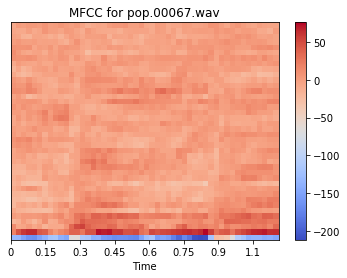

In [20]:
time_step = R.randint(0, n_mfcc_submaps)
ex.plot_one_mfcc(mfcc_ex, time_step)

And random MFCCs from each genre:

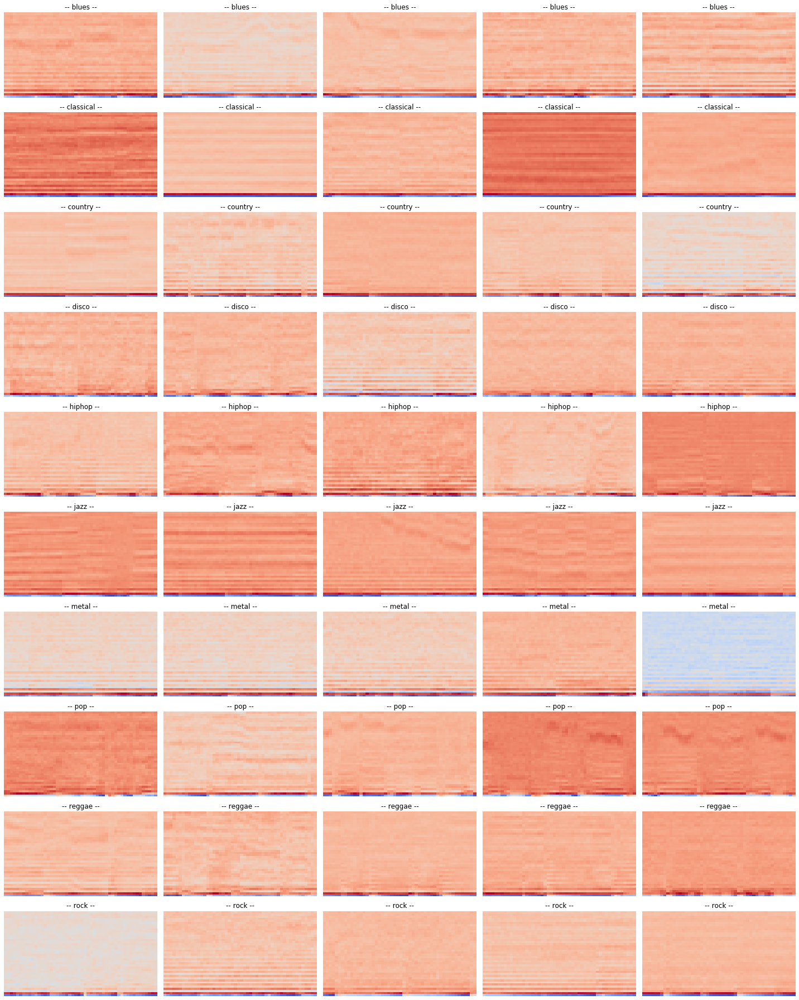

In [21]:
ex.plot_random_mfccs(mfccs, n_per_genre=5, seed=seed)

Seems like a hard visual classification problem, we'll see how well our networks do on that.